# Differentially expressed gene analysis on super-boundaries

In [1]:
#load packages
library(Seurat)
library(ggplot2)
library(magrittr)
library(data.table)
library(Matrix)
library(dplyr)
library(tibble)
library(MAST)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:data.table’:

    between, first, last


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Loading required package: SingleCellExperiment

Loading required package: SummarizedExperiment

Loading required package: MatrixGenerics

Loading required package: matrixStats


Attaching package: ‘matrixStats’


The following object is masked from ‘package:dplyr’:

    count



Attaching package: ‘MatrixGenerics’


The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
 

In [2]:
#load data
seu_PR <- readRDS(file = "../../data/seurat_object/Set3/seu_lateralect_PR_ID.obj")

In [3]:
seu_PR

An object of class Seurat 
28745 features across 1717 samples within 2 assays 
Active assay: SCT (11239 features, 3000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, reumap

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
Warning message:
“Using `as.character()` on a quosure is deprecated as of rlang 0.3.0.
Please use `as_label()` or `as_name()` instead.
This warning is displayed once per session.”


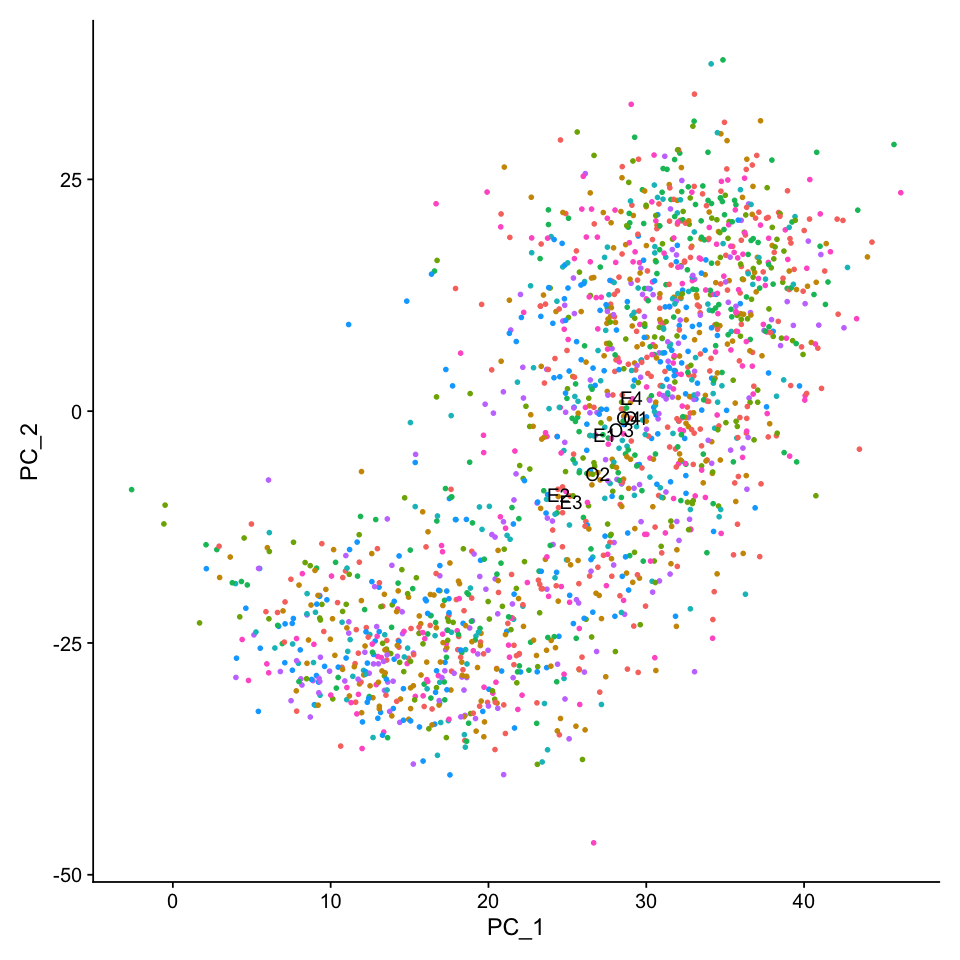

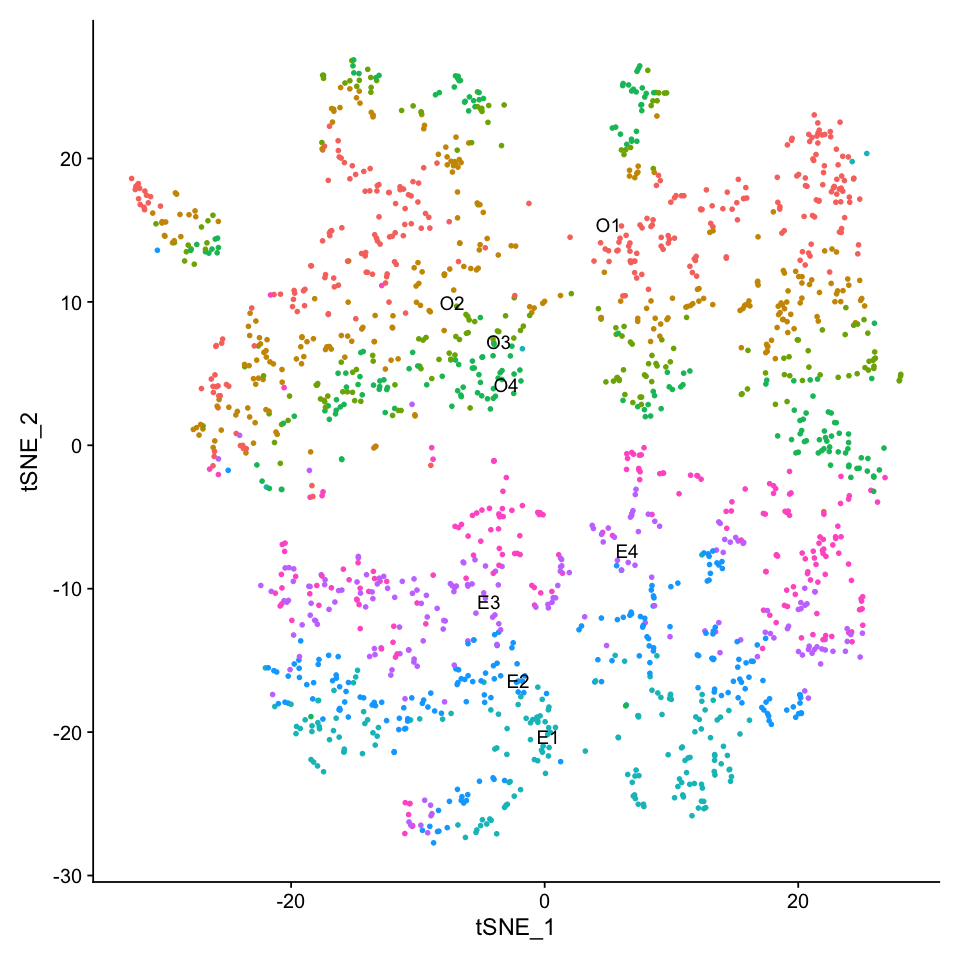

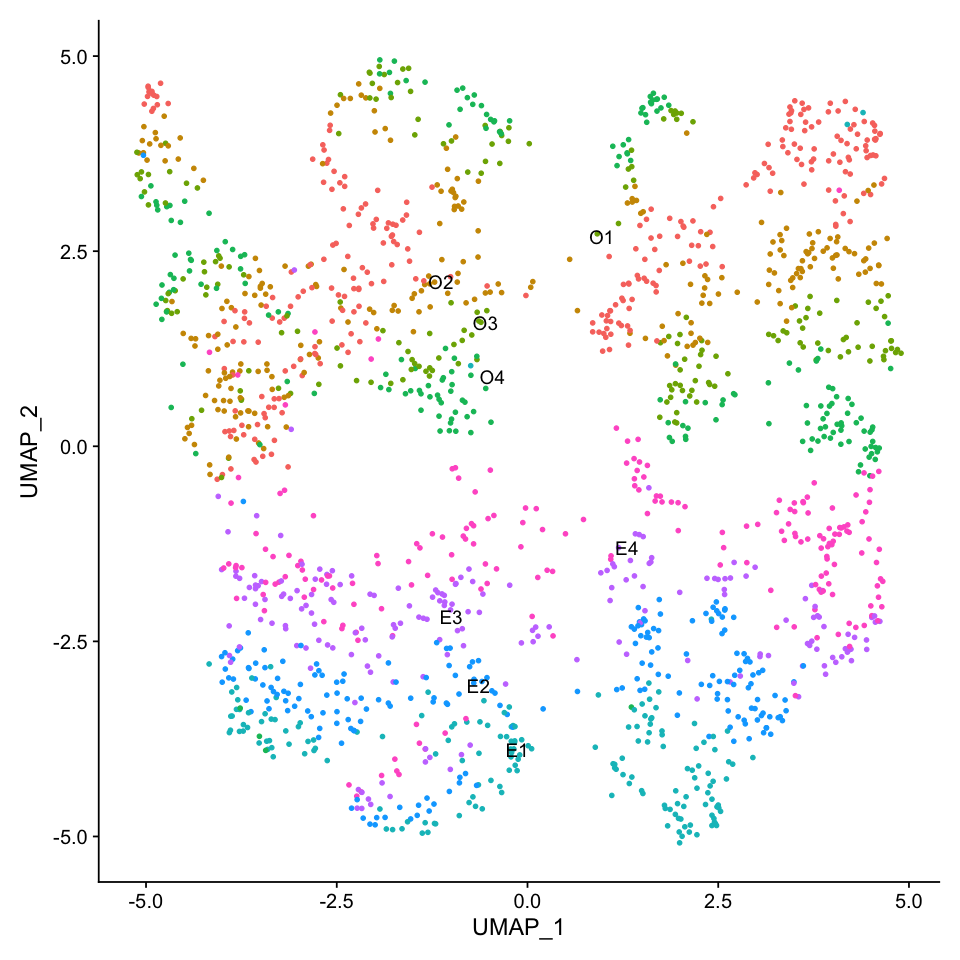

In [4]:
options(repr.plot.width=8, repr.plot.height=8)
seu_PR <- RunPCA(seu_PR, verbose = FALSE)
seu_PR <- RunTSNE(seu_PR, dims = 1:30, verbose = FALSE)
seu_PR <- RunUMAP(seu_PR, dims = 1:30, verbose = FALSE)
DimPlot(seu_PR, reduction =  "pca", label = TRUE) + NoLegend()
DimPlot(seu_PR, reduction =  "tsne", label = TRUE) + NoLegend()
DimPlot(seu_PR, reduction =  "umap", label = TRUE) + NoLegend()

## DEG analysis

In [5]:
Idents(seu_PR) <- "pairrule_ID"

In [6]:
levels <- c("O1","O2","O3","O4", "E1","E2","E3","E4")
levels(seu_PR) <- levels

In [7]:
seu_PR_VF3000 <- seu_PR[VariableFeatures(seu_PR), ]
seu_PR_VF3000

An object of class Seurat 
6000 features across 1717 samples within 2 assays 
Active assay: SCT (3000 features, 3000 variable features)
 1 other assay present: RNA
 4 dimensional reductions calculated: pca, umap, reumap, tsne

### O1 vs. O3


 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>------


 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
pxb,5.136233e-145,2.1899253,1.000,0.354,1.540870e-141,O1vsO3
hh,2.411509e-139,2.3203573,0.996,0.053,7.234526e-136,O1vsO3
eve,1.197291e-109,2.2680469,0.989,0.455,3.591872e-106,O1vsO3
mid,5.917636e-108,1.8990632,0.965,0.328,1.775291e-104,O1vsO3
run,9.223584e-106,-1.9959873,0.302,0.989,2.767075e-102,O1vsO3
en,1.114449e-100,1.9535365,0.944,0.095,3.343346e-97,O1vsO3
Tollo,1.366343e-99,1.1862407,1.000,0.963,4.099028e-96,O1vsO3
slp1,2.465666e-98,-1.9855340,0.330,0.979,7.396998e-95,O1vsO3
comm,1.290806e-90,-1.8895844,0.253,0.937,3.872419e-87,O1vsO3


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
pxb,5.136233e-145,2.1899253,1.000,0.354,1.540870e-141
hh,2.411509e-139,2.3203573,0.996,0.053,7.234526e-136
eve,1.197291e-109,2.2680469,0.989,0.455,3.591872e-106
mid,5.917636e-108,1.8990632,0.965,0.328,1.775291e-104
en,1.114449e-100,1.9535365,0.944,0.095,3.343346e-97
Tollo,1.366343e-99,1.1862407,1.000,0.963,4.099028e-96
gsb,7.253283e-68,2.3132185,0.814,0.085,2.175985e-64
rdx,5.772280e-60,0.8305945,1.000,0.989,1.731684e-56
pri,8.200040e-53,1.6484577,0.909,0.455,2.460012e-49


[1] 15  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
run,9.223584e-106,-1.9959873,0.302,0.989,2.767075e-102
slp1,2.465666e-98,-1.9855340,0.330,0.979,7.396998e-95
comm,1.290806e-90,-1.8895844,0.253,0.937,3.872419e-87
comm2,2.323505e-68,-1.2020814,0.084,0.804,6.970515e-65
slp2,2.472826e-31,-0.6392766,0.035,0.466,7.418478e-28
pio,5.836477e-26,-0.8958120,0.396,0.767,1.750943e-22
Toll-6,1.848670e-23,-0.9460775,0.863,0.958,5.546011e-20
CG15480,1.041433e-20,-0.9307150,0.670,0.910,3.124298e-17
rst,1.787548e-19,-0.5848501,0.109,0.455,5.362645e-16


[1] 15  5

[1] "DEGs O1vsO3, avgFC >= 1.75, FWER <= 0.01"

[1] "DEGs O1vsO3, avgFC <= -1.75, FWER <= 0.01"

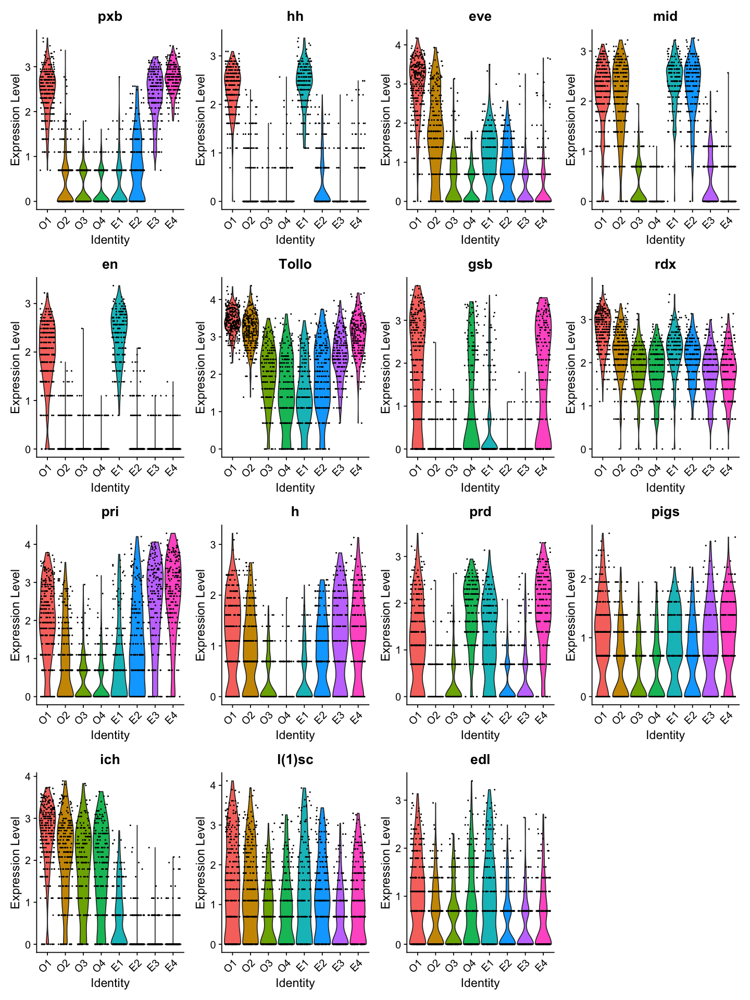

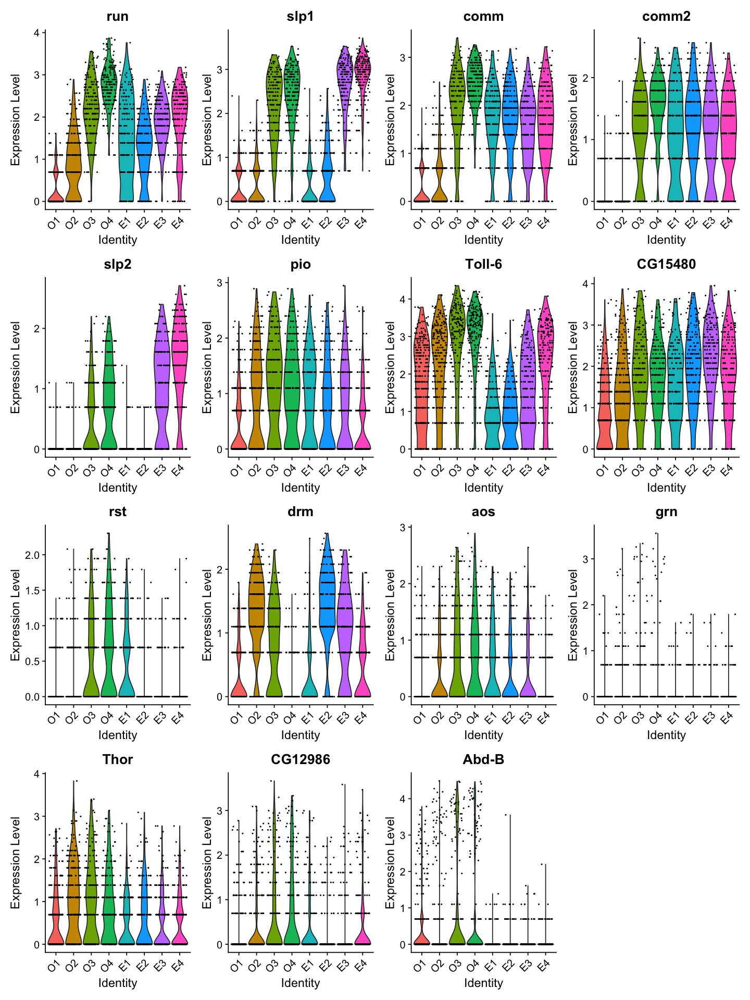

In [8]:
DE_O1vsO3 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "O1",
  ident.2 = "O3",
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_O1vsO3_FWER0.01_FC1.75 <- filter(DE_O1vsO3, p_val_adj <= 0.01 & abs(avg_logFC) >= log(1.75) )

compaired_ID <- rep("O1vsO3", length=nrow(DE_O1vsO3_FWER0.01_FC1.75)) 
DE_O1vsO3_FWER0.01_FC1.75 <- cbind(DE_O1vsO3_FWER0.01_FC1.75, compaired_ID)
DE_O1vsO3_FWER0.01_FC1.75

DE_O1vsO3_FWER0.01_FC1.75_plus <- filter(DE_O1vsO3, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_O1vsO3_FWER0.01_FC1.75_plus
dim(DE_O1vsO3_FWER0.01_FC1.75_plus)
DE_O1vsO3_FWER0.01_FC1.75_minus <- filter(DE_O1vsO3, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_O1vsO3_FWER0.01_FC1.75_minus
dim(DE_O1vsO3_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_O1vsO3_FWER0.01_FC1.75_plus)/4))
"DEGs O1vsO3, avgFC >= 1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O1vsO3_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O1vsO3_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O1vsO3_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_O1vsO3_FWER0.01_FC1.75_minus)/4))
"DEGs O1vsO3, avgFC <= -1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O1vsO3_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O1vsO3_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O1vsO3_FWER0.01_FC1.75_minus)/4))

write.table(DE_O1vsO3_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_O1vsO3_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)

### O2 vs. O4


 Completed [====================>-----------------------]  48% with 0 failures

 Completed [=====================>----------------------]  49% with 0 failures

 Completed [=====================>----------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [=======================>--------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>

                                                                              


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
wg,1.149100e-126,-2.1947538,0.069,0.995,3.447299e-123,O2vsO4
comm,3.931650e-125,-1.8901320,0.406,1.000,1.179495e-121,O2vsO4
odd,3.173974e-117,1.8238289,0.973,0.230,9.521923e-114,O2vsO4
run,2.082411e-116,-1.6904059,0.713,1.000,6.247234e-113,O2vsO4
slp1,9.013281e-114,-2.0952301,0.375,0.975,2.703984e-110,O2vsO4
mid,1.752841e-109,2.0770401,0.973,0.176,5.258523e-106,O2vsO4
18w,2.768843e-105,-1.7029283,0.575,0.985,8.306528e-102,O2vsO4
comm2,8.705371e-97,-1.4191207,0.157,0.966,2.611611e-93,O2vsO4
prd,1.242615e-90,-1.6642258,0.226,0.966,3.727846e-87,O2vsO4


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
odd,3.173974e-117,1.8238289,0.973,0.230,9.521923e-114
mid,1.752841e-109,2.0770401,0.973,0.176,5.258523e-106
Tollo,3.177866e-85,1.2744213,1.000,0.858,9.533597e-82
sob,1.408625e-75,1.2704703,0.889,0.123,4.225875e-72
drm,1.336238e-71,1.2117757,0.916,0.201,4.008714e-68
eve,9.944164e-47,1.7257007,0.835,0.377,2.983249e-43
h,1.999919e-34,0.9744181,0.705,0.181,5.999757e-31
toc,1.373877e-24,1.2422441,0.724,0.324,4.121632e-21
upd1,3.410345e-21,0.8522119,0.410,0.059,1.023104e-17


[1] 14  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
wg,1.149100e-126,-2.1947538,0.069,0.995,3.447299e-123
comm,3.931650e-125,-1.8901320,0.406,1.000,1.179495e-121
run,2.082411e-116,-1.6904059,0.713,1.000,6.247234e-113
slp1,9.013281e-114,-2.0952301,0.375,0.975,2.703984e-110
18w,2.768843e-105,-1.7029283,0.575,0.985,8.306528e-102
comm2,8.705371e-97,-1.4191207,0.157,0.966,2.611611e-93
prd,1.242615e-90,-1.6642258,0.226,0.966,3.727846e-87
slp2,3.082588e-48,-0.9101337,0.046,0.642,9.247765e-45
gsb,6.457802e-32,-1.6531197,0.123,0.554,1.937341e-28


[1] 11  5

[1] "DEGs O2vsO4, avgFC >= 1.75, FWER <= 0.01"

[1] "DEGs O2vsO4, avgFC <= -1.75, FWER <= 0.01"

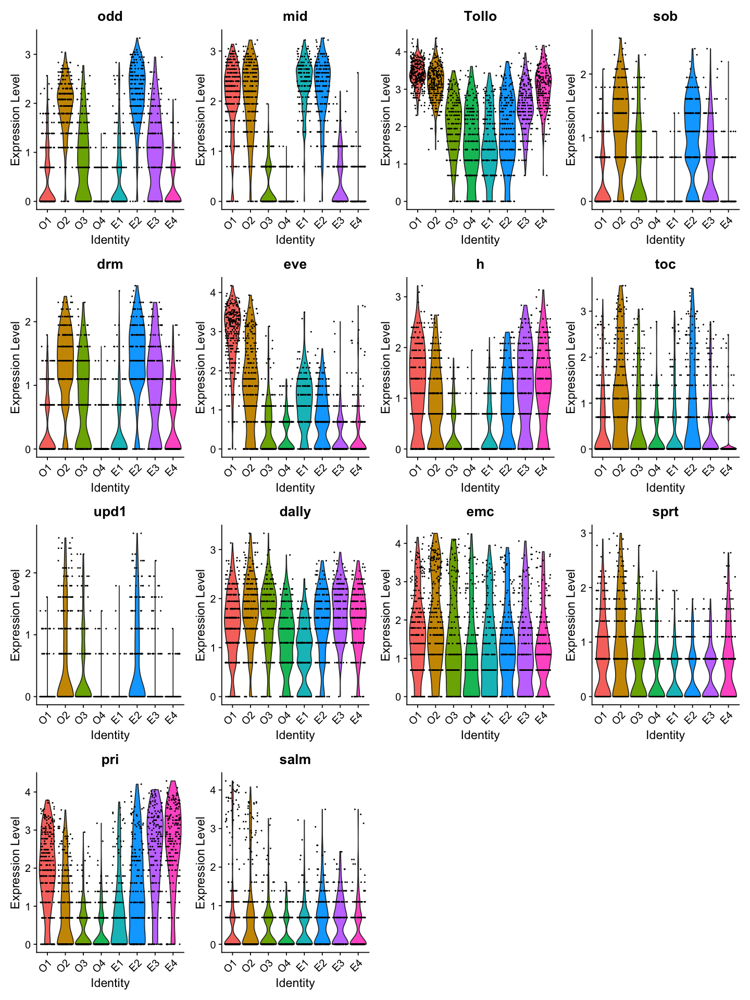

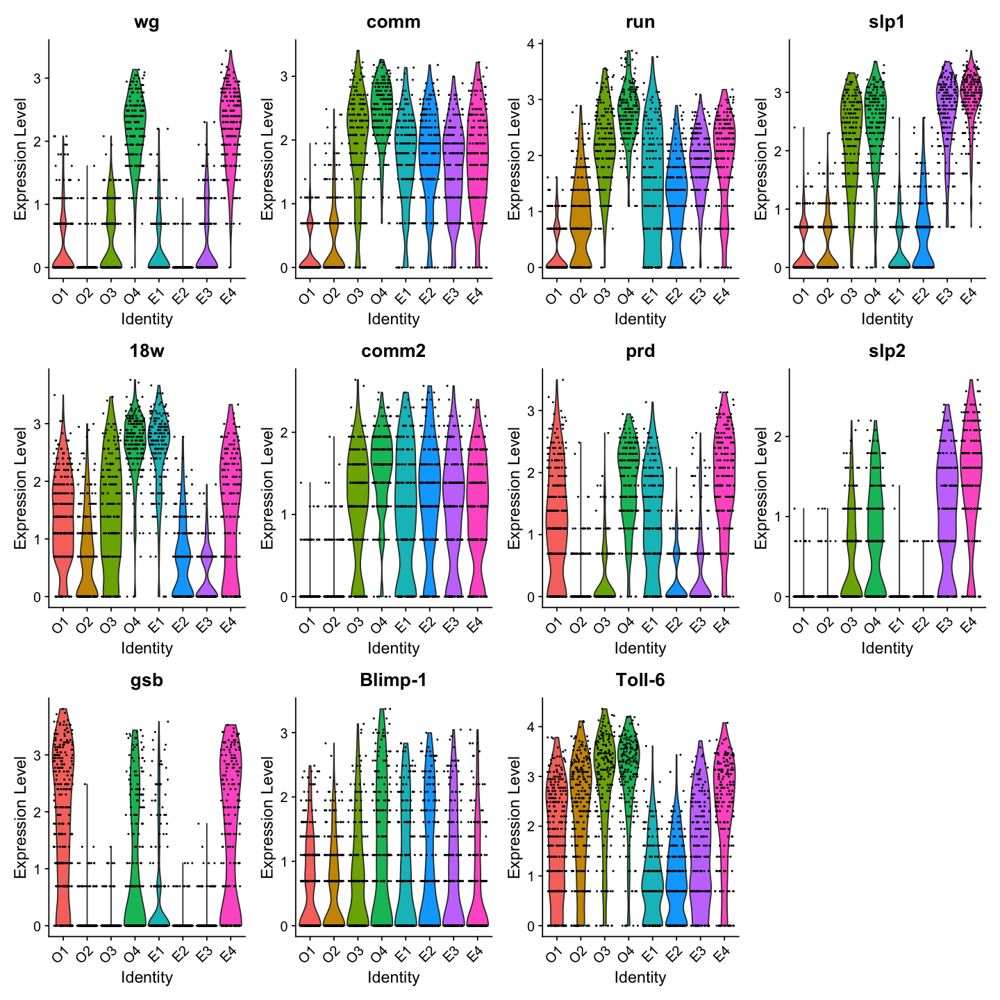

In [9]:
DE_O2vsO4 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "O2",
  ident.2 = "O4",
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_O2vsO4_FWER0.01_FC1.75 <- filter(DE_O2vsO4, p_val_adj <= 0.01 & abs(avg_logFC) >= log(1.75))

compaired_ID <- rep("O2vsO4", length=nrow(DE_O2vsO4_FWER0.01_FC1.75)) 
DE_O2vsO4_FWER0.01_FC1.75 <- cbind(DE_O2vsO4_FWER0.01_FC1.75, compaired_ID)
DE_O2vsO4_FWER0.01_FC1.75

DE_O2vsO4_FWER0.01_FC1.75_plus <- filter(DE_O2vsO4, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_O2vsO4_FWER0.01_FC1.75_plus
dim(DE_O2vsO4_FWER0.01_FC1.75_plus)
DE_O2vsO4_FWER0.01_FC1.75_minus <- filter(DE_O2vsO4, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_O2vsO4_FWER0.01_FC1.75_minus
dim(DE_O2vsO4_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_O2vsO4_FWER0.01_FC1.75_plus)/4))
"DEGs O2vsO4, avgFC >= 1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O2vsO4_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O2vsO4_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O2vsO4_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_O2vsO4_FWER0.01_FC1.75_minus)/4))
"DEGs O2vsO4, avgFC <= -1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O2vsO4_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O2vsO4_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O2vsO4_FWER0.01_FC1.75_minus)/4))

write.table(DE_O2vsO4_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_O2vsO4_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)





### O3 vs. E1


 Completed [=====================>----------------------]  50% with 0 failures

 Completed [======================>---------------------]  51% with 0 failures

 Completed [======================>---------------------]  52% with 0 failures

 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>


 Completed [=======================================>----]  91% with 0 failures

 Completed [========================================>---]  92% with 0 failures

 Completed [========================================>---]  93% with 0 failures

 Completed [========================================>---]  94% with 0 failures

 Completed [=========================================>--]  95% with 0 failures

 Completed [=========================================>--]  96% with 0 failures

 Completed [==========================================>-]  97% with 0 failures

 Completed [==========================================>-]  98% with 0 failures

 Completed [===========================================>]  99% with 0 failures

 Completed [============================================] 100% with 0 failures
                                                                              


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
trn,2.540815e-154,-2.6263970,0.831,1.000,7.622444e-151,O3vsE1
ftz,3.853257e-131,-2.6116275,0.302,1.000,1.155977e-127,O3vsE1
mid,3.452346e-114,-2.0746863,0.328,0.994,1.035704e-110,O3vsE1
hh,8.208353e-112,-2.4218866,0.053,1.000,2.462506e-108,O3vsE1
en,3.543545e-105,-2.2931649,0.095,1.000,1.063063e-101,O3vsE1
slp1,3.180251e-73,1.9291527,0.979,0.328,9.540754e-70,O3vsE1
Toll-6,2.169475e-54,1.8957931,0.958,0.712,6.508426e-51,O3vsE1
ImpL2,1.159588e-43,1.2468863,1.000,0.966,3.478763e-40,O3vsE1
18w,1.276633e-30,-0.8621948,0.831,0.977,3.829900e-27,O3vsE1


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
slp1,3.180251e-73,1.9291527,0.979,0.328,9.540754e-70
Toll-6,2.169475e-54,1.8957931,0.958,0.712,6.508426e-51
ImpL2,1.159588e-43,1.2468863,1.000,0.966,3.478763e-40
ich,5.013043e-28,1.2496012,0.884,0.525,1.503913e-24
dally,1.794881e-24,0.7433968,0.942,0.751,5.384642e-21
slp2,4.447019e-21,0.6115496,0.466,0.051,1.334106e-17
path,1.710845e-15,0.5796684,0.968,0.881,5.132534e-12
sob,6.755176e-14,0.6079414,0.450,0.119,2.026553e-10
Abd-B,1.052195e-13,2.1509810,0.333,0.090,3.156585e-10


[1] 15  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
trn,2.540815e-154,-2.6263970,0.831,1.000,7.622444e-151
ftz,3.853257e-131,-2.6116275,0.302,1.000,1.155977e-127
mid,3.452346e-114,-2.0746863,0.328,0.994,1.035704e-110
hh,8.208353e-112,-2.4218866,0.053,1.000,2.462506e-108
en,3.543545e-105,-2.2931649,0.095,1.000,1.063063e-101
18w,1.276633e-30,-0.8621948,0.831,0.977,3.829900e-27
prd,2.520883e-29,-1.0805371,0.280,0.791,7.562649e-26
blot,1.452566e-19,-0.6169328,0.931,0.994,4.357697e-16
CG4702,1.458743e-18,-1.2002856,0.164,0.554,4.376229e-15


[1] 16  5

[1] "DEGs O3vsE1, avgFC >= 1.75, FWER <= 0.01"

[1] "DEGs O3vsE1, avgFC <= -1.75, FWER <= 0.01"

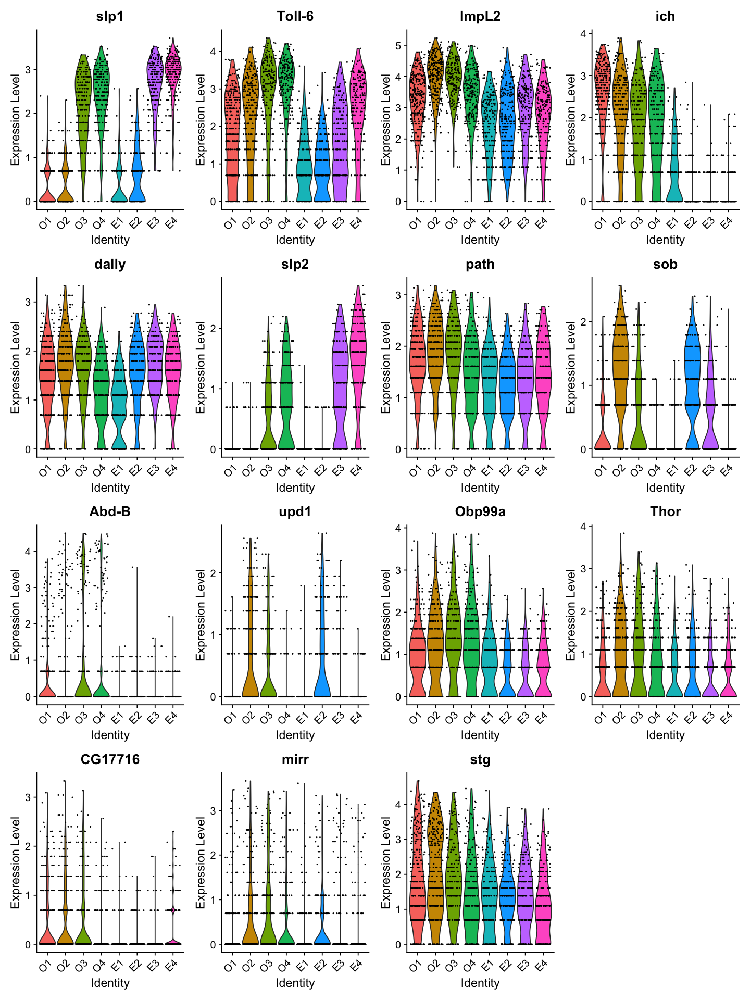

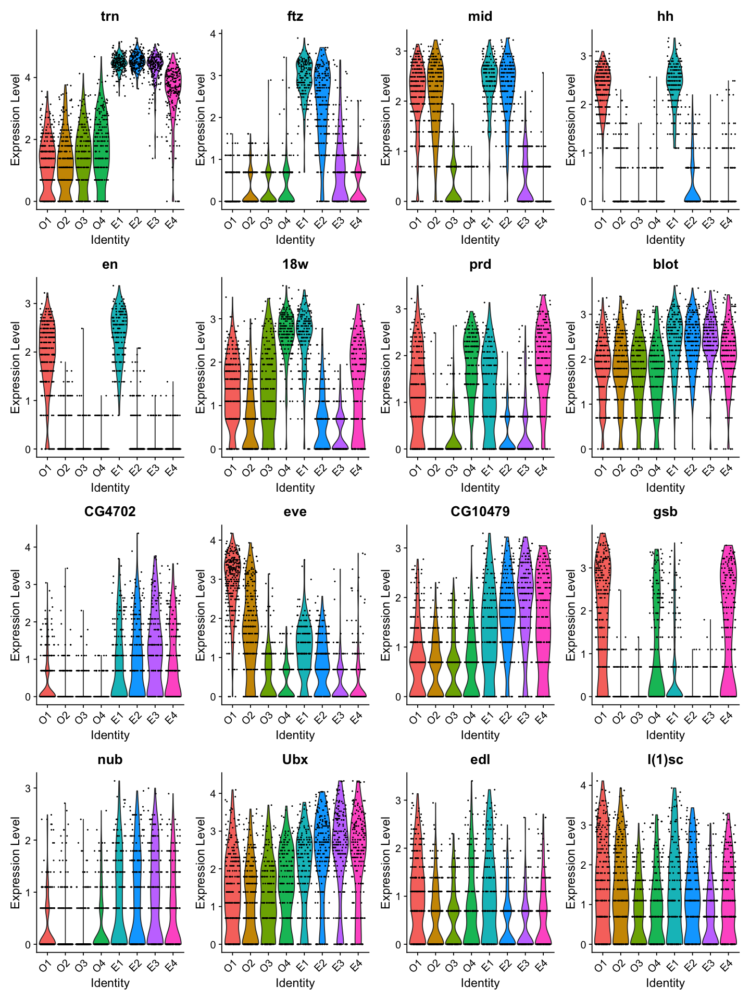

In [10]:
DE_O3vsE1 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "O3",
  ident.2 = "E1",
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_O3vsE1_FWER0.01_FC1.75 <- filter(DE_O3vsE1, p_val_adj <= 0.01 & abs(avg_logFC) >= log(1.75))

compaired_ID <- rep("O3vsE1", length=nrow(DE_O3vsE1_FWER0.01_FC1.75)) 
DE_O3vsE1_FWER0.01_FC1.75 <- cbind(DE_O3vsE1_FWER0.01_FC1.75, compaired_ID)
DE_O3vsE1_FWER0.01_FC1.75

DE_O3vsE1_FWER0.01_FC1.75_plus <- filter(DE_O3vsE1, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_O3vsE1_FWER0.01_FC1.75_plus
dim(DE_O3vsE1_FWER0.01_FC1.75_plus)
DE_O3vsE1_FWER0.01_FC1.75_minus <- filter(DE_O3vsE1, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_O3vsE1_FWER0.01_FC1.75_minus
dim(DE_O3vsE1_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_O3vsE1_FWER0.01_FC1.75_plus)/4))
"DEGs O3vsE1, avgFC >= 1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O3vsE1_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O3vsE1_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O3vsE1_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_O3vsE1_FWER0.01_FC1.75_minus)/4))
"DEGs O3vsE1, avgFC <= -1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O3vsE1_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O3vsE1_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O3vsE1_FWER0.01_FC1.75_minus)/4))

write.table(DE_O3vsE1_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_O3vsE1_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)


### O4 vs. E2


 Completed [================>---------------------------]  39% with 0 failures

 Completed [================>---------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>--------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  42% with 0 failures

 Completed [==================>-------------------------]  43% with 0 failures

 Completed [==================>-------------------------]  44% with 0 failures

 Completed [===================>------------------------]  45% with 0 failures

 Completed [===================>------------------------]  46% with 0 failures

 Completed [====================>-----------------------]  47% with 0 failures

 Completed [====================>-----------------------]  48% with 0 failures

 Completed [=====================>-----


 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [===========================

,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
trn,4.881209e-145,-2.3143987,0.877,1.000,1.464363e-141,O4vsE2
wg,2.727803e-117,2.2495551,0.995,0.054,8.183409e-114,O4vsE2
mid,2.489834e-112,-2.1966137,0.176,0.990,7.469501e-109,O4vsE2
odd,2.044031e-110,-2.1143079,0.230,0.980,6.132093e-107,O4vsE2
18w,1.869428e-103,1.8191854,0.985,0.567,5.608285e-100,O4vsE2
slp1,2.838404e-83,1.7507723,0.975,0.542,8.515212e-80,O4vsE2
run,9.482468e-83,1.3658455,1.000,0.813,2.844741e-79,O4vsE2
Toll-6,4.318505e-80,1.9803946,0.961,0.714,1.295551e-76,O4vsE2
prd,1.728988e-77,1.6229105,0.966,0.296,5.186964e-74,O4vsE2


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
wg,2.727803e-117,2.2495551,0.995,0.054,8.183409e-114
18w,1.869428e-103,1.8191854,0.985,0.567,5.608285e-100
slp1,2.838404e-83,1.7507723,0.975,0.542,8.515212e-80
run,9.482468e-83,1.3658455,1.000,0.813,2.844741e-79
Toll-6,4.318505e-80,1.9803946,0.961,0.714,1.295551e-76
prd,1.728988e-77,1.6229105,0.966,0.296,5.186964e-74
ich,6.925707e-55,1.8491417,0.853,0.202,2.077712e-51
slp2,1.117203e-40,0.9085821,0.642,0.059,3.351610e-37
halo,1.139345e-39,1.3825932,0.926,0.576,3.418035e-36


[1] 17  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
trn,4.881209e-145,-2.3143987,0.877,1.000,1.464363e-141
mid,2.489834e-112,-2.1966137,0.176,0.990,7.469501e-109
odd,2.044031e-110,-2.1143079,0.230,0.980,6.132093e-107
ftz,2.006596e-72,-2.0023960,0.338,0.936,6.019787e-69
drm,1.788683e-69,-1.3137566,0.201,0.921,5.366050e-66
sob,3.458422e-52,-1.0491411,0.123,0.803,1.037527e-48
5-HT2A,4.740819e-38,-1.0503888,0.554,0.916,1.422246e-34
CG10479,1.469197e-33,-0.9878838,0.593,0.941,4.407591e-30
CG4702,2.040146e-31,-1.4690143,0.152,0.650,6.120437e-28


[1] 25  5

[1] "DEGs O4vsE2, avgFC >= 1.75, FWER <= 0.01"

[1] "DEGs O4vsE2, avgFC <= -1.75, FWER <= 0.01"

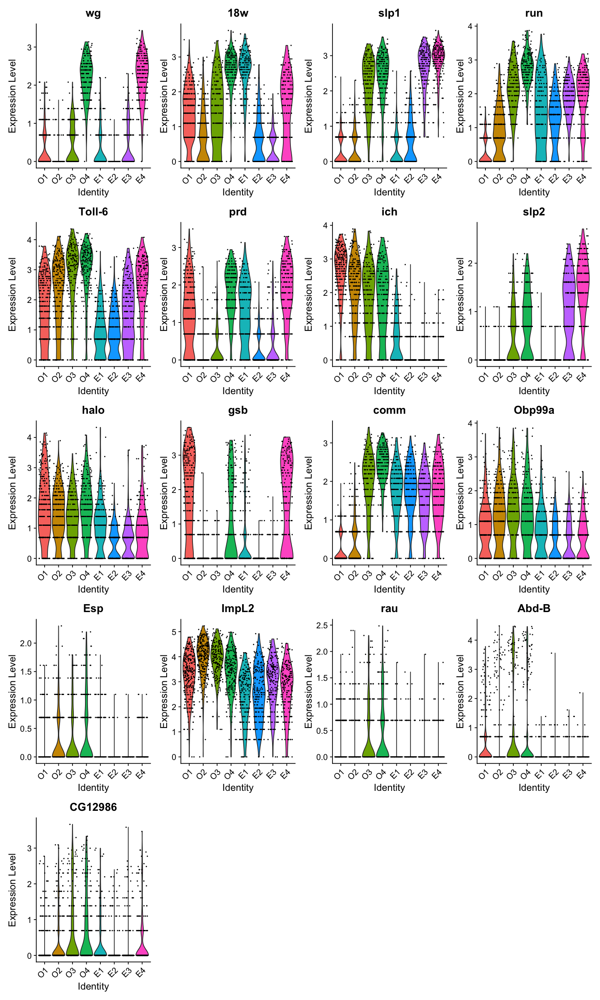

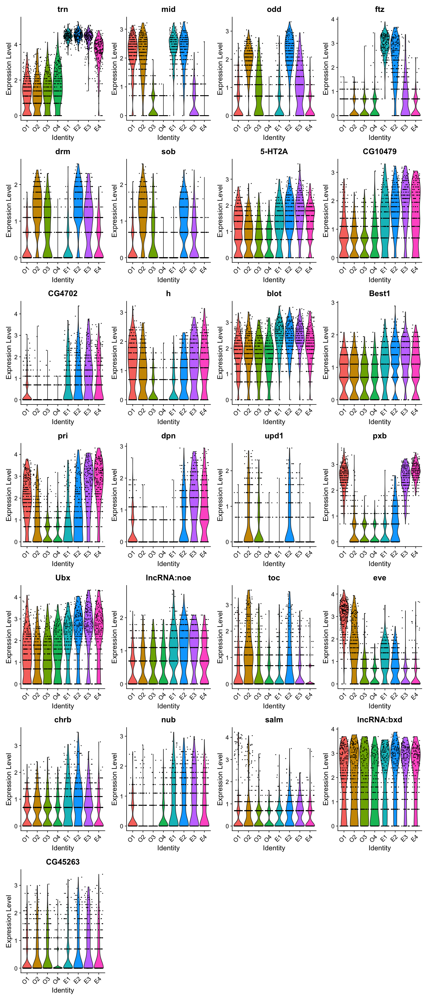

In [11]:
DE_O4vsE2 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "O4",
  ident.2 = "E2",
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_O4vsE2_FWER0.01_FC1.75 <- filter(DE_O4vsE2, p_val_adj <= 0.01 & abs(avg_logFC) >= log(1.75))

compaired_ID <- rep("O4vsE2", length=nrow(DE_O4vsE2_FWER0.01_FC1.75)) 
DE_O4vsE2_FWER0.01_FC1.75 <- cbind(DE_O4vsE2_FWER0.01_FC1.75, compaired_ID)
DE_O4vsE2_FWER0.01_FC1.75

DE_O4vsE2_FWER0.01_FC1.75_plus <- filter(DE_O4vsE2, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_O4vsE2_FWER0.01_FC1.75_plus
dim(DE_O4vsE2_FWER0.01_FC1.75_plus)
DE_O4vsE2_FWER0.01_FC1.75_minus <- filter(DE_O4vsE2, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_O4vsE2_FWER0.01_FC1.75_minus
dim(DE_O4vsE2_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_O4vsE2_FWER0.01_FC1.75_plus)/4))
"DEGs O4vsE2, avgFC >= 1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O4vsE2_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O4vsE2_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O4vsE2_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_O4vsE2_FWER0.01_FC1.75_minus)/4))
"DEGs O4vsE2, avgFC <= -1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O4vsE2_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_O4vsE2_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O4vsE2_FWER0.01_FC1.75_minus)/4))

write.table(DE_O4vsE2_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_O4vsE2_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)


### E1 vs. E3


 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  64% with 0 failures

 Completed [===========================>----------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [==============================>-------------]  69% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===========================

,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
en,6.199194e-110,2.3376252,1.000,0.098,1.859758e-106,E1vsE3
hh,4.881649e-107,2.3540319,1.000,0.062,1.464495e-103,E1vsE3
slp1,4.981122e-103,-2.3258984,0.328,1.000,1.494337e-99,E1vsE3
mid,1.012420e-102,1.8718736,0.994,0.397,3.037259e-99,E1vsE3
18w,2.884203e-102,2.2113348,0.977,0.418,8.652608e-99,E1vsE3
pxb,1.189446e-100,-2.0097785,0.328,1.000,3.568338e-97,E1vsE3
ftz,1.868126e-91,1.8008848,1.000,0.567,5.604379e-88,E1vsE3
slp2,5.372533e-51,-1.1812572,0.051,0.763,1.611760e-47,E1vsE3
dpn,3.057613e-49,-1.4311615,0.085,0.789,9.172839e-46,E1vsE3


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
en,6.199194e-110,2.3376252,1.000,0.098,1.859758e-106
hh,4.881649e-107,2.3540319,1.000,0.062,1.464495e-103
mid,1.012420e-102,1.8718736,0.994,0.397,3.037259e-99
18w,2.884203e-102,2.2113348,0.977,0.418,8.652608e-99
ftz,1.868126e-91,1.8008848,1.000,0.567,5.604379e-88
eve,8.236580e-30,0.8852183,0.853,0.351,2.470974e-26
Sema5c,3.691904e-27,0.8491047,0.836,0.423,1.107571e-23
prd,3.542694e-20,0.8206398,0.791,0.361,1.062808e-16
edl,2.397445e-15,0.9310614,0.701,0.412,7.192335e-12


[1] 16  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
slp1,4.981122e-103,-2.3258984,0.328,1.000,1.494337e-99
pxb,1.189446e-100,-2.0097785,0.328,1.000,3.568338e-97
slp2,5.372533e-51,-1.1812572,0.051,0.763,1.611760e-47
dpn,3.057613e-49,-1.4311615,0.085,0.789,9.172839e-46
dally,4.235237e-36,-0.8117342,0.751,0.995,1.270571e-32
Tollo,4.120921e-31,-0.8184714,0.898,1.000,1.236276e-27
pri,1.011795e-29,-1.3103917,0.576,0.912,3.035385e-26
h,1.741819e-22,-0.9434435,0.373,0.763,5.225457e-19
drm,7.221481e-22,-0.7295599,0.277,0.742,2.166444e-18


[1] 15  5

[1] "DEGs E1vsE3, avgFC >= 1.75, FWER <= 0.01"

[1] "DEGs E1vsE3, avgFC <= -1.75, FWER <= 0.01"

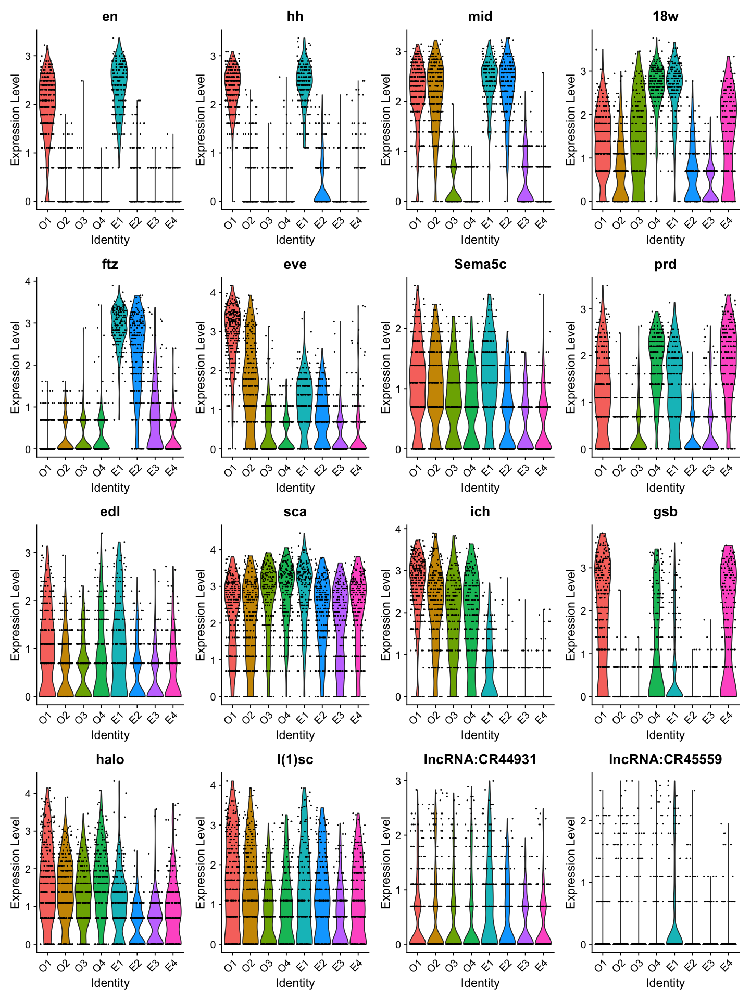

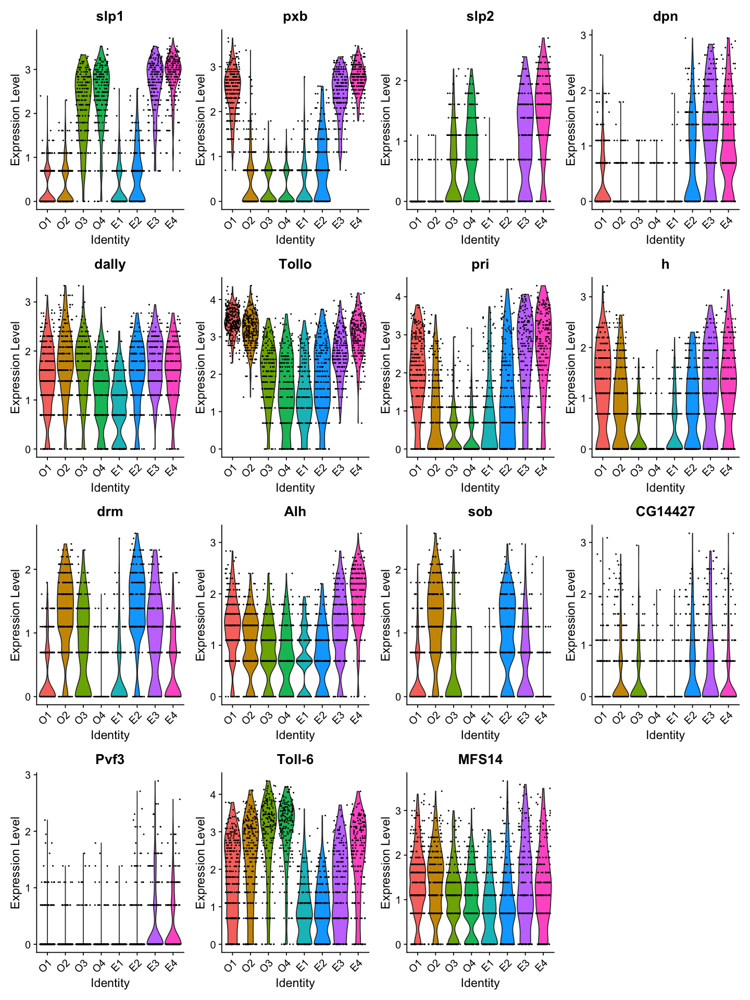

In [12]:
DE_E1vsE3 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "E1",
  ident.2 = "E3",
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_E1vsE3_FWER0.01_FC1.75 <- filter(DE_E1vsE3, p_val_adj <= 0.01 & abs(avg_logFC) >= log(1.75))

compaired_ID <- rep("E1vsE3", length=nrow(DE_E1vsE3_FWER0.01_FC1.75)) 
DE_E1vsE3_FWER0.01_FC1.75 <- cbind(DE_E1vsE3_FWER0.01_FC1.75, compaired_ID)
DE_E1vsE3_FWER0.01_FC1.75

DE_E1vsE3_FWER0.01_FC1.75_plus <- filter(DE_E1vsE3, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_E1vsE3_FWER0.01_FC1.75_plus
dim(DE_E1vsE3_FWER0.01_FC1.75_plus)
DE_E1vsE3_FWER0.01_FC1.75_minus <- filter(DE_E1vsE3, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_E1vsE3_FWER0.01_FC1.75_minus
dim(DE_E1vsE3_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_E1vsE3_FWER0.01_FC1.75_plus)/4))
"DEGs E1vsE3, avgFC >= 1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E1vsE3_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E1vsE3_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E1vsE3_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_E1vsE3_FWER0.01_FC1.75_minus)/4))
"DEGs E1vsE3, avgFC <= -1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E1vsE3_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E1vsE3_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E1vsE3_FWER0.01_FC1.75_minus)/4))

write.table(DE_E1vsE3_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_E1vsE3_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)


### E2 vs. E4


 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  76% with 0 failures

 Completed [=================================>----------]  77% with 0 failures

 Completed [=================================>----------]  78% with 0 failures

 Completed [==================================>---------]  79% with 0 failures

 Completed [===========================

,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
slp1,6.316822e-128,-2.1263088,0.542,1.000,1.895047e-124,E2vsE4
pxb,1.389375e-127,-1.7262565,0.635,1.000,4.168125e-124,E2vsE4
wg,9.451181e-115,-2.3027743,0.054,0.995,2.835354e-111,E2vsE4
mid,2.358301e-106,2.1058216,0.990,0.201,7.074903e-103,E2vsE4
odd,1.169025e-97,1.9153937,0.980,0.304,3.507074e-94,E2vsE4
slp2,2.413315e-79,-1.5771766,0.059,0.882,7.239946e-76,E2vsE4
ftz,7.154735e-75,2.0927048,0.936,0.353,2.146420e-71,E2vsE4
prd,3.650543e-70,-1.7459280,0.296,0.941,1.095163e-66,E2vsE4
Alh,1.499851e-57,-1.0818120,0.739,0.975,4.499552e-54,E2vsE4


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
mid,2.358301e-106,2.1058216,0.990,0.201,7.074903e-103
odd,1.169025e-97,1.9153937,0.980,0.304,3.507074e-94
ftz,7.154735e-75,2.0927048,0.936,0.353,2.146420e-71
trn,1.868136e-50,0.8226007,1.000,0.975,5.604409e-47
drm,1.970822e-47,0.9772844,0.921,0.456,5.912465e-44
sob,5.563339e-42,0.9318351,0.803,0.196,1.669002e-38
upd1,3.732635e-21,0.8295744,0.424,0.059,1.119790e-17
toc,2.197161e-16,1.1347788,0.571,0.250,6.591482e-13
cv-c,2.050164e-15,0.6508083,0.911,0.716,6.150492e-12


[1] 10  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
slp1,6.316822e-128,-2.1263088,0.542,1.000,1.895047e-124
pxb,1.389375e-127,-1.7262565,0.635,1.000,4.168125e-124
wg,9.451181e-115,-2.3027743,0.054,0.995,2.835354e-111
slp2,2.413315e-79,-1.5771766,0.059,0.882,7.239946e-76
prd,3.650543e-70,-1.7459280,0.296,0.941,1.095163e-66
Alh,1.499851e-57,-1.0818120,0.739,0.975,4.499552e-54
gsb,1.985363e-50,-2.1627166,0.074,0.691,5.956089e-47
Toll-6,7.458718e-43,-1.4463803,0.714,0.902,2.237616e-39
Tollo,2.125292e-42,-0.8938096,0.926,1.000,6.375877e-39


[1] 16  5

[1] "DEGs E2vsE4, avgFC >= 1.75, FWER <= 0.01"

[1] "DEGs E2vsE4, avgFC <= -1.75, FWER <= 0.01"

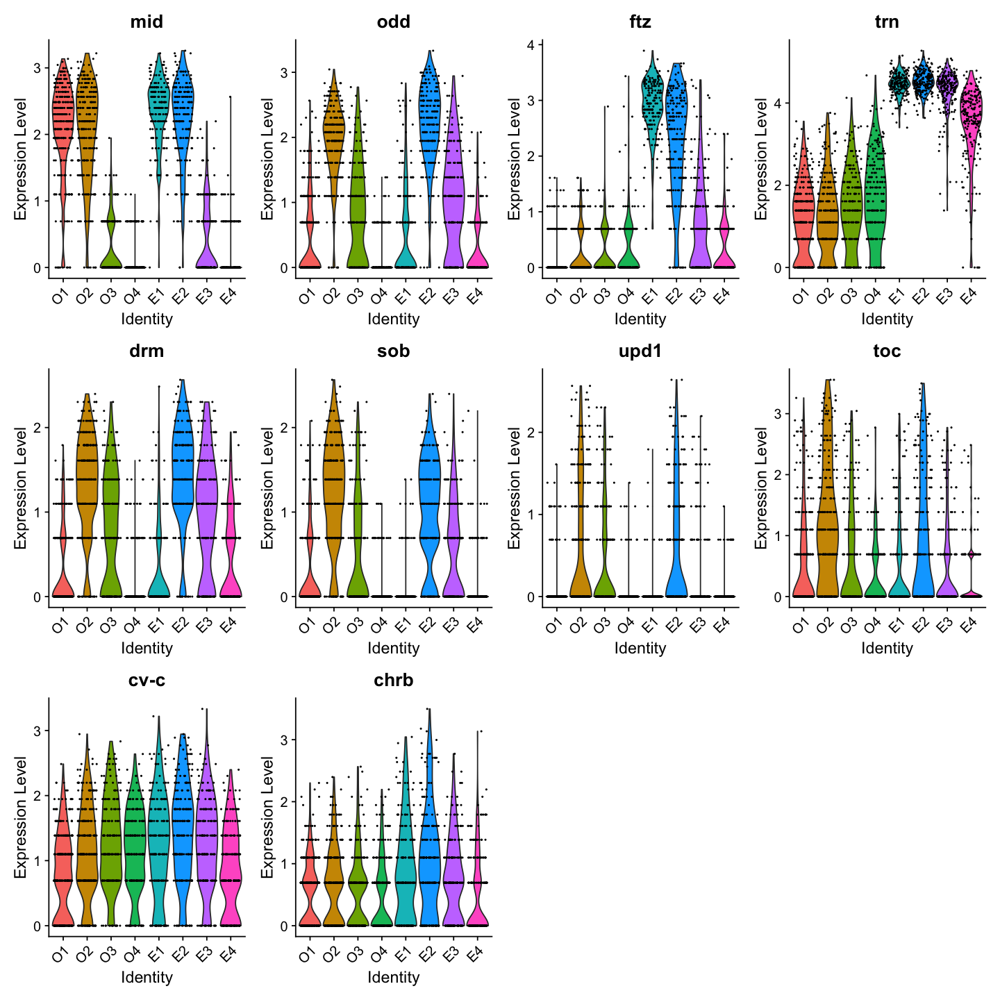

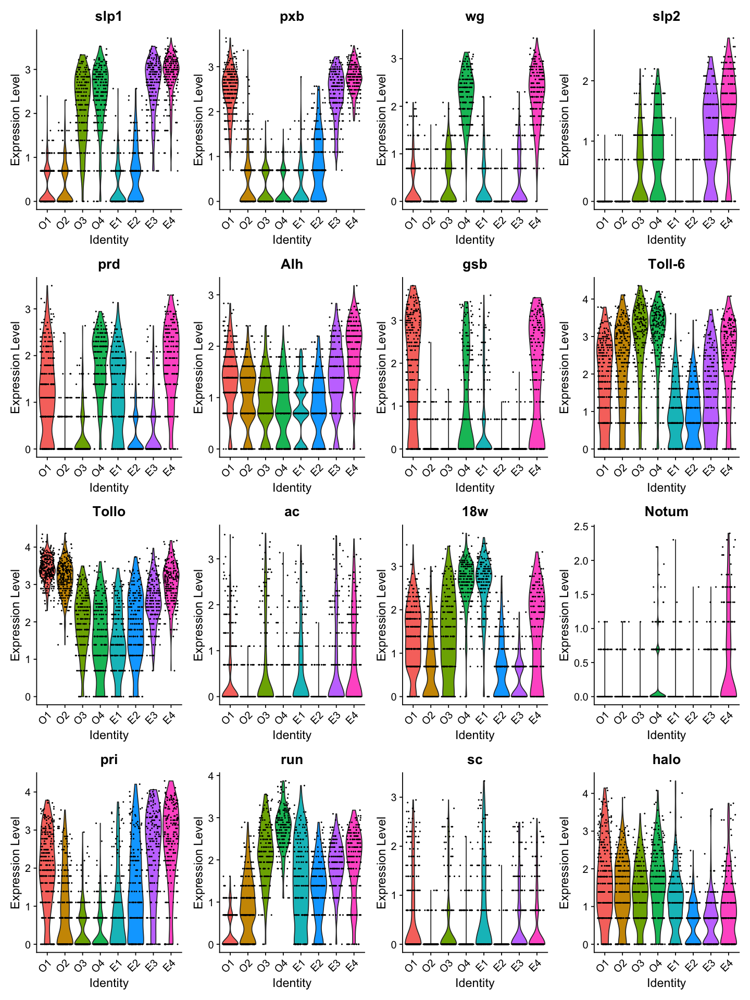

In [13]:
DE_E2vsE4 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "E2",
  ident.2 = "E4",
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_E2vsE4_FWER0.01_FC1.75 <- filter(DE_E2vsE4, p_val_adj <= 0.01 & abs(avg_logFC) >= log(1.75))

compaired_ID <- rep("E2vsE4", length=nrow(DE_E2vsE4_FWER0.01_FC1.75)) 
DE_E2vsE4_FWER0.01_FC1.75 <- cbind(DE_E2vsE4_FWER0.01_FC1.75, compaired_ID)
DE_E2vsE4_FWER0.01_FC1.75

DE_E2vsE4_FWER0.01_FC1.75_plus <- filter(DE_E2vsE4, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_E2vsE4_FWER0.01_FC1.75_plus
dim(DE_E2vsE4_FWER0.01_FC1.75_plus)
DE_E2vsE4_FWER0.01_FC1.75_minus <- filter(DE_E2vsE4, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_E2vsE4_FWER0.01_FC1.75_minus
dim(DE_E2vsE4_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_E2vsE4_FWER0.01_FC1.75_plus)/4))
"DEGs E2vsE4, avgFC >= 1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E2vsE4_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E2vsE4_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E2vsE4_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_E2vsE4_FWER0.01_FC1.75_minus)/4))
"DEGs E2vsE4, avgFC <= -1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E2vsE4_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E2vsE4_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E2vsE4_FWER0.01_FC1.75_minus)/4))

write.table(DE_E2vsE4_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_E2vsE4_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)

### E3 vs. O1


 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>----------------------------]  37% with 0 failures

 Completed [================>---------------------------]  38% with 0 failures

 Completed [================>---------------------------]  39% with 0 failures

 Completed [=================>--------------------------]  40% with 0 failures

 Completed [=================>--------------------------]  41% with 0 failures

 Completed [=================>---------


 Completed [============================>---------------]  65% with 0 failures

 Completed [============================>---------------]  66% with 0 failures

 Completed [=============================>--------------]  67% with 0 failures

 Completed [=============================>--------------]  68% with 0 failures

 Completed [=============================>--------------]  69% with 0 failures

 Completed [==============================>-------------]  70% with 0 failures

 Completed [==============================>-------------]  71% with 0 failures

 Completed [===============================>------------]  72% with 0 failures

 Completed [===============================>------------]  73% with 0 failures

 Completed [===============================>------------]  74% with 0 failures

 Completed [================================>-----------]  74% with 0 failures

 Completed [================================>-----------]  75% with 0 failures

 Completed [===========================

,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
trn,4.805775e-181,2.8265645,1.000,0.751,1.441733e-177,E3vsO1
slp1,1.104400e-136,2.3822797,1.000,0.330,3.313199e-133,E3vsO1
hh,1.711688e-133,-2.2525026,0.062,0.996,5.135065e-130,E3vsO1
eve,2.242387e-123,-2.5260607,0.351,0.989,6.727161e-120,E3vsO1
ich,9.527554e-119,-2.5564066,0.191,0.954,2.858266e-115,E3vsO1
run,2.692631e-105,1.6332040,0.985,0.302,8.077893e-102,E3vsO1
en,5.177299e-105,-1.9979968,0.098,0.944,1.553190e-101,E3vsO1
mid,2.926479e-95,-1.6962504,0.397,0.965,8.779436e-92,E3vsO1
comm,1.816198e-79,1.4546954,0.948,0.253,5.448595e-76,E3vsO1


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
trn,4.805775e-181,2.8265645,1.000,0.751,1.441733e-177
slp1,1.104400e-136,2.3822797,1.000,0.330,3.313199e-133
run,2.692631e-105,1.6332040,0.985,0.302,8.077893e-102
comm,1.816198e-79,1.4546954,0.948,0.253,5.448595e-76
slp2,9.092030e-71,1.2089843,0.763,0.035,2.727609e-67
comm2,9.780807e-62,1.1512057,0.768,0.084,2.934242e-58
CG10479,6.736932e-44,1.0888689,0.912,0.656,2.021080e-40
Ppa,1.066339e-40,0.6052541,1.000,0.993,3.199017e-37
CG15480,4.420476e-39,1.1201126,0.959,0.670,1.326143e-35


[1] 19  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
hh,1.711688e-133,-2.2525026,0.062,0.996,5.135065e-130
eve,2.242387e-123,-2.5260607,0.351,0.989,6.727161e-120
ich,9.527554e-119,-2.5564066,0.191,0.954,2.858266e-115
en,5.177299e-105,-1.9979968,0.098,0.944,1.553190e-101
mid,2.926479e-95,-1.6962504,0.397,0.965,8.779436e-92
rdx,1.004958e-69,-0.9300209,0.995,1.000,3.014874e-66
gsb,2.315740e-66,-2.2798155,0.113,0.814,6.947220e-63
Tollo,7.746373e-65,-0.7741319,1.000,1.000,2.323912e-61
18w,6.653589e-46,-1.1718360,0.418,0.898,1.996077e-42


[1] 19  5

[1] "DEGs E3vsO1, avgFC >= 1.75, FWER <= 0.01"

[1] "DEGs E3vsO1, avgFC <= -1.75, FWER <= 0.01"

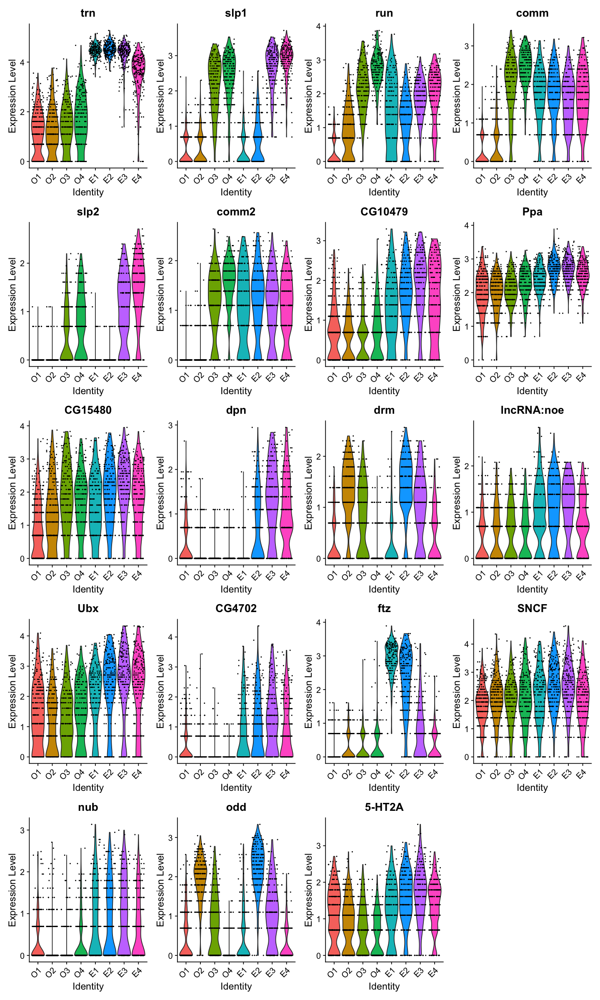

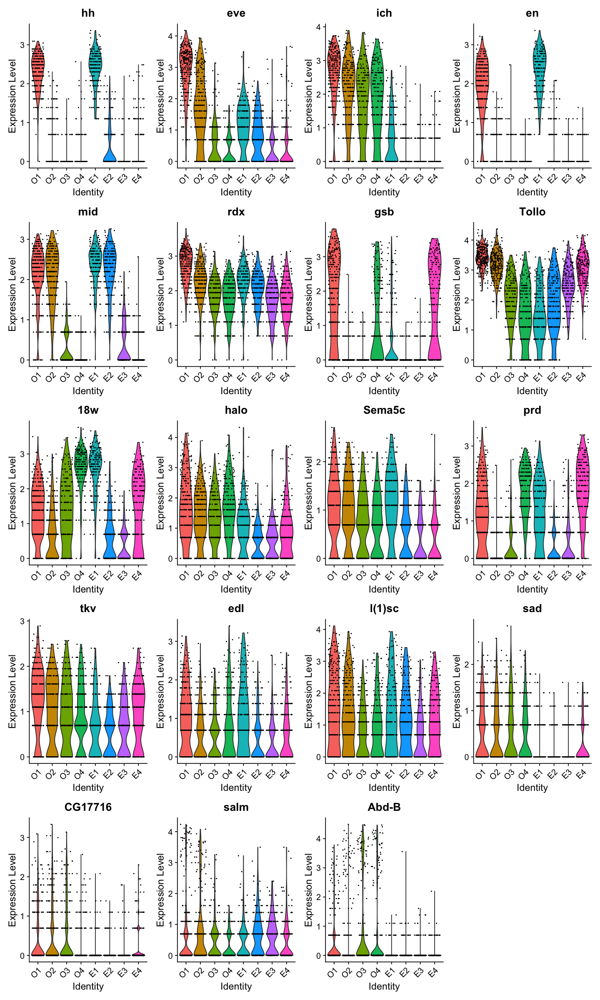

In [14]:
DE_E3vsO1 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "E3",
  ident.2 = "O1",
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_E3vsO1_FWER0.01_FC1.75 <- filter(DE_E3vsO1, p_val_adj <= 0.01 & abs(avg_logFC) >= log(1.75))

compaired_ID <- rep("E3vsO1", length=nrow(DE_E3vsO1_FWER0.01_FC1.75)) 
DE_E3vsO1_FWER0.01_FC1.75 <- cbind(DE_E3vsO1_FWER0.01_FC1.75, compaired_ID)
DE_E3vsO1_FWER0.01_FC1.75

DE_E3vsO1_FWER0.01_FC1.75_plus <- filter(DE_E3vsO1, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_E3vsO1_FWER0.01_FC1.75_plus
dim(DE_E3vsO1_FWER0.01_FC1.75_plus)
DE_E3vsO1_FWER0.01_FC1.75_minus <- filter(DE_E3vsO1, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_E3vsO1_FWER0.01_FC1.75_minus
dim(DE_E3vsO1_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_E3vsO1_FWER0.01_FC1.75_plus)/4))
"DEGs E3vsO1, avgFC >= 1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E3vsO1_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E3vsO1_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E3vsO1_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_E3vsO1_FWER0.01_FC1.75_minus)/4))
"DEGs E3vsO1, avgFC <= -1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E3vsO1_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E3vsO1_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E3vsO1_FWER0.01_FC1.75_minus)/4))

write.table(DE_E3vsO1_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_E3vsO1_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)

### E4 vs. O2


 Completed [==========>---------------------------------]  26% with 0 failures

 Completed [===========>--------------------------------]  27% with 0 failures

 Completed [===========>--------------------------------]  28% with 0 failures

 Completed [============>-------------------------------]  29% with 0 failures

 Completed [============>-------------------------------]  30% with 0 failures

 Completed [=============>------------------------------]  31% with 0 failures

 Completed [=============>------------------------------]  32% with 0 failures

 Completed [=============>------------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  33% with 0 failures

 Completed [==============>-----------------------------]  34% with 0 failures

 Completed [==============>-----------------------------]  35% with 0 failures

 Completed [===============>----------------------------]  36% with 0 failures

 Completed [===============>-----------


 Completed [======================>---------------------]  53% with 0 failures

 Completed [=======================>--------------------]  54% with 0 failures

 Completed [=======================>--------------------]  55% with 0 failures

 Completed [========================>-------------------]  56% with 0 failures

 Completed [========================>-------------------]  57% with 0 failures

 Completed [========================>-------------------]  58% with 0 failures

 Completed [=========================>------------------]  58% with 0 failures

 Completed [=========================>------------------]  59% with 0 failures

 Completed [=========================>------------------]  60% with 0 failures

 Completed [==========================>-----------------]  61% with 0 failures

 Completed [==========================>-----------------]  62% with 0 failures

 Completed [===========================>----------------]  63% with 0 failures

 Completed [===========================

,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
slp1,2.716963e-162,2.4707665,1.000,0.375,8.150890e-159,E4vsO2
pxb,4.507993e-157,2.0898043,1.000,0.402,1.352398e-153,E4vsO2
wg,4.135200e-124,2.2479730,0.995,0.069,1.240560e-120,E4vsO2
mid,1.570145e-103,-1.9862480,0.201,0.973,4.710435e-100,E4vsO2
odd,5.782830e-101,-1.6249148,0.304,0.973,1.734849e-97,E4vsO2
trn,7.877599e-97,2.0146648,0.975,0.808,2.363280e-93,E4vsO2
slp2,4.478100e-91,1.5787282,0.882,0.046,1.343430e-87,E4vsO2
prd,4.132819e-83,1.7872433,0.941,0.226,1.239846e-79,E4vsO2
ich,2.815701e-79,-2.0753224,0.230,0.931,8.447103e-76,E4vsO2


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
slp1,2.716963e-162,2.4707665,1.000,0.375,8.150890e-159
pxb,4.507993e-157,2.0898043,1.000,0.402,1.352398e-153
wg,4.135200e-124,2.2479730,0.995,0.069,1.240560e-120
trn,7.877599e-97,2.0146648,0.975,0.808,2.363280e-93
slp2,4.478100e-91,1.5787282,0.882,0.046,1.343430e-87
prd,4.132819e-83,1.7872433,0.941,0.226,1.239846e-79
comm,1.226938e-57,1.2865409,0.951,0.406,3.680815e-54
gsb,2.009372e-53,2.0596211,0.691,0.123,6.028116e-50
comm2,3.725032e-50,0.9963641,0.794,0.157,1.117510e-46


[1] 23  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
mid,1.570145e-103,-1.9862480,0.201,0.973,4.710435e-100
odd,5.782830e-101,-1.6249148,0.304,0.973,1.734849e-97
ich,2.815701e-79,-2.0753224,0.230,0.931,8.447103e-76
sob,3.193160e-64,-1.1531643,0.196,0.889,9.579481e-61
drm,1.326446e-44,-0.8753035,0.456,0.916,3.979337e-41
ImpL2,9.158788e-44,-1.0728297,0.966,0.996,2.747636e-40
eve,2.240182e-36,-1.2591861,0.328,0.835,6.720547e-33
Pino,8.982662e-32,-0.6443070,0.971,1.000,2.694799e-28
toc,5.968357e-30,-1.3215539,0.250,0.724,1.790507e-26


[1] 17  5

[1] "DEGs E4vsO2, avgFC >= 1.75, FWER <= 0.01"

[1] "DEGs E4vsO2, avgFC <= -1.75, FWER <= 0.01"

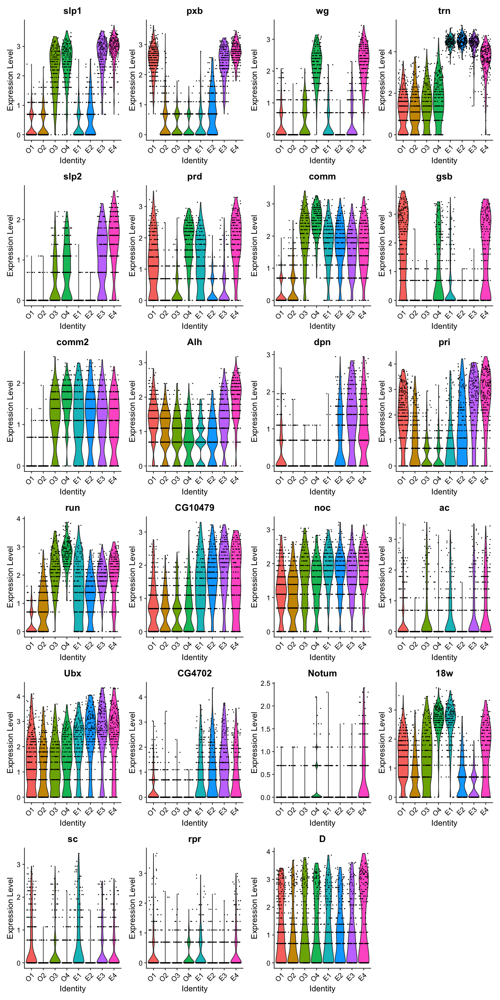

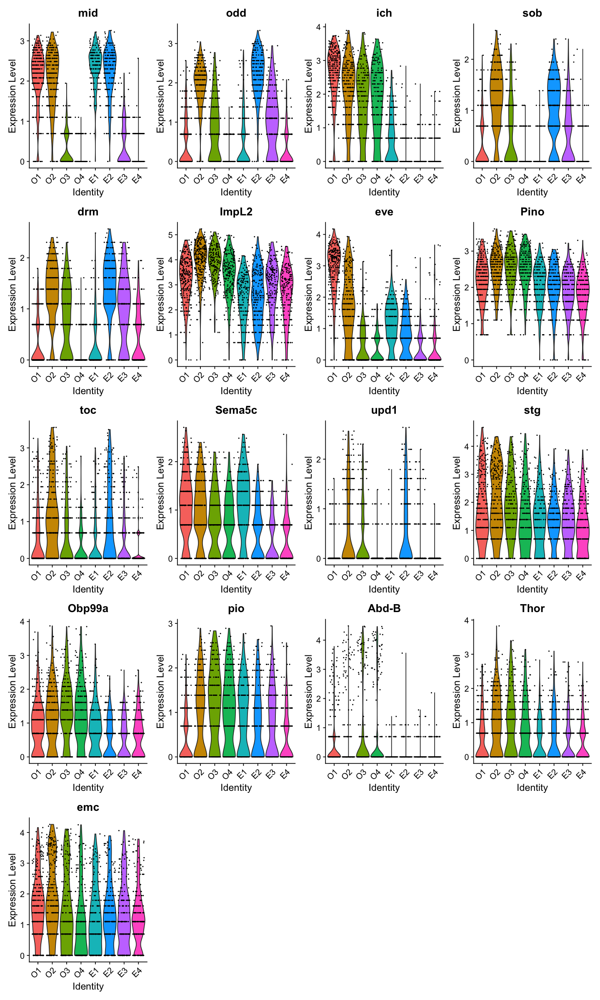

In [15]:
DE_E4vsO2 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "E4",
  ident.2 = "O2",
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_E4vsO2_FWER0.01_FC1.75 <- filter(DE_E4vsO2, p_val_adj <= 0.01 & abs(avg_logFC) >= log(1.75))

compaired_ID <- rep("E4vsO2", length=nrow(DE_E4vsO2_FWER0.01_FC1.75)) 
DE_E4vsO2_FWER0.01_FC1.75 <- cbind(DE_E4vsO2_FWER0.01_FC1.75, compaired_ID)
DE_E4vsO2_FWER0.01_FC1.75

DE_E4vsO2_FWER0.01_FC1.75_plus <- filter(DE_E4vsO2, p_val_adj <= 0.01 & avg_logFC >= log(1.75) )
DE_E4vsO2_FWER0.01_FC1.75_plus
dim(DE_E4vsO2_FWER0.01_FC1.75_plus)
DE_E4vsO2_FWER0.01_FC1.75_minus <- filter(DE_E4vsO2, p_val_adj <= 0.01 & avg_logFC <= -log(1.75) )
DE_E4vsO2_FWER0.01_FC1.75_minus
dim(DE_E4vsO2_FWER0.01_FC1.75_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_E4vsO2_FWER0.01_FC1.75_plus)/4))
"DEGs E4vsO2, avgFC >= 1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E4vsO2_FWER0.01_FC1.75_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E4vsO2_plus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E4vsO2_FWER0.01_FC1.75_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_E4vsO2_FWER0.01_FC1.75_minus)/4))
"DEGs E4vsO2, avgFC <= -1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E4vsO2_FWER0.01_FC1.75_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_E4vsO2_minus_FC1.75.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E4vsO2_FWER0.01_FC1.75_minus)/4))

write.table(DE_E4vsO2_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_E4vsO2_FWER0.01_FC1.75.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)

## Merge results

In [16]:
DE_O1vsO3_FWER0.01_FC1.75 <- DE_O1vsO3_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_O2vsO4_FWER0.01_FC1.75 <- DE_O2vsO4_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_O3vsE1_FWER0.01_FC1.75 <- DE_O3vsE1_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_O4vsE2_FWER0.01_FC1.75 <- DE_O4vsE2_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_E1vsE3_FWER0.01_FC1.75 <- DE_E1vsE3_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_E2vsE4_FWER0.01_FC1.75 <- DE_E2vsE4_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_E3vsO1_FWER0.01_FC1.75 <- DE_E3vsO1_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_E4vsO2_FWER0.01_FC1.75 <- DE_E4vsO2_FWER0.01_FC1.75 %>% rownames_to_column("gene_name")
DE_all_FWER0.01_FC1.75 <- rbind(DE_O1vsO3_FWER0.01_FC1.75, DE_O2vsO4_FWER0.01_FC1.75, DE_O3vsE1_FWER0.01_FC1.75, 
                              DE_O4vsE2_FWER0.01_FC1.75, DE_E1vsE3_FWER0.01_FC1.75, DE_E2vsE4_FWER0.01_FC1.75,
                             DE_E3vsO1_FWER0.01_FC1.75, DE_E4vsO2_FWER0.01_FC1.75)

In [17]:
DE_all_FWER0.01_FC1.75

gene_name,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
pxb,5.136233e-145,2.1899253,1.000,0.354,1.540870e-141,O1vsO3
hh,2.411509e-139,2.3203573,0.996,0.053,7.234526e-136,O1vsO3
eve,1.197291e-109,2.2680469,0.989,0.455,3.591872e-106,O1vsO3
mid,5.917636e-108,1.8990632,0.965,0.328,1.775291e-104,O1vsO3
run,9.223584e-106,-1.9959873,0.302,0.989,2.767075e-102,O1vsO3
en,1.114449e-100,1.9535365,0.944,0.095,3.343346e-97,O1vsO3
Tollo,1.366343e-99,1.1862407,1.000,0.963,4.099028e-96,O1vsO3
slp1,2.465666e-98,-1.9855340,0.330,0.979,7.396998e-95,O1vsO3
comm,1.290806e-90,-1.8895844,0.253,0.937,3.872419e-87,O1vsO3


In [18]:
table(DE_all_FWER0.01_FC1.75$compaired_ID)


E1vsE3 E2vsE4 E3vsO1 E4vsO2 O1vsO3 O2vsO4 O3vsE1 O4vsE2 
    31     26     38     40     30     25     31     42 

In [19]:
length(unique(DE_all_FWER0.01_FC1.75$gene_name))

[1] 84

In [20]:
write.table(DE_all_FWER0.01_FC1.75, file = "./DEG_superboundary_FC1.75/DEGs_all_FWER0.01_FC1.75_superboundary.txt", 
            sep="\t", col.names=T, row.names=F, quote=F)

In [21]:
write(unique(DE_all_FWER0.01_FC1.75$gene_name), file = "./DEG_superboundary_FC1.75/unique_DEGs_list_FWER0.01_FC1.75_superboundary.txt" )

[1] "DEGs all unique, avgFC <= -1.75, FWER <= 0.01"

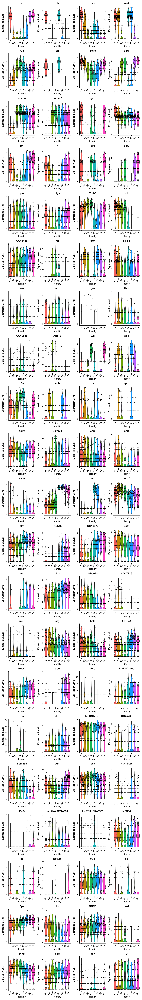

In [22]:
options(repr.plot.width=12, repr.plot.height=4*ceiling(length(unique(DE_all_FWER0.01_FC1.75$gene_name))/4))
"DEGs all unique, avgFC <= -1.75, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = unique(DE_all_FWER0.01_FC1.75$gene_name), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC1.75/DEGs_unique_all_FC1.75_superboundary.png", 
       width = 10.24, height = 2.56*ceiling(length(unique(DE_all_FWER0.01_FC1.75$gene_name))/4), limitsize = FALSE)

In [23]:
unique(DE_all_FWER0.01_FC1.75$gene_name)

[1] "pxb"            "hh"             "eve"            "mid"           
 [5] "run"            "en"             "Tollo"          "slp1"          
 [9] "comm"           "comm2"          "gsb"            "rdx"           
[13] "pri"            "h"              "prd"            "slp2"          
[17] "pio"            "pigs"           "Toll-6"         "ich"           
[21] "CG15480"        "rst"            "drm"            "l(1)sc"        
[25] "aos"            "edl"            "grn"            "Thor"          
[29] "CG12986"        "Abd-B"          "wg"             "odd"           
[33] "18w"            "sob"            "toc"            "upd1"          
[37] "dally"          "Blimp-1"        "emc"            "sprt"          
[41] "salm"           "trn"            "ftz"            "ImpL2"         
[45] "blot"           "CG4702"         "CG10479"        "path"          
[49] "nub"            "Ubx"            "Obp99a"         "CG17716"       
[53] "mirr"           "stg"            "halo"           "5-HT2A"        
[57] "Best1"          "dpn"            "Esp"            "lncRNA:noe"    
[61] "rau"            "chrb"           "lncRNA:bxd"     "CG45263"       
[65] "Sema5c"         "Alh"            "sca"            "CG14427"       
[69] "Pvf3"           "lncRNA:CR44931" "lncRNA:CR45559" "MFS14"         
[73] "ac"             "Notum"          "cv-c"           "sc"            
[77] "Ppa"            "tkv"            "SNCF"           "sad"           
[81] "Pino"           "noc"            "rpr"            "D"

In [24]:
options(repr.plot.width=3, repr.plot.height=4)
for (i in unique(DE_all_FWER0.01_FC1.75$gene_name)){
plot <- VlnPlot(seu_PR_VF3000, features = paste(i), pt.size = 0.2, ncol = 1)  + 
scale_fill_manual(values = c("skyblue1", "skyblue2", "skyblue3", "skyblue4", "magenta1", "magenta2", "magenta3", "magenta4")) +
NoLegend()
ggsave(filename=paste("./DEG_superboundary_FC1.75/unique_plot/DEGs_unique_all_FC1.75_",i,".png", sep=""), 
       width = 3.84, height = 5.12, limitsize = FALSE)
}



In [25]:
sessionInfo()

R version 4.0.3 (2020-10-10)
Platform: x86_64-apple-darwin17.0 (64-bit)
Running under: macOS Catalina 10.15.7

Matrix products: default
BLAS:   /Library/Frameworks/R.framework/Versions/4.0/Resources/lib/libRblas.dylib
LAPACK: /Library/Frameworks/R.framework/Versions/4.0/Resources/lib/libRlapack.dylib

locale:
[1] ja_JP.UTF-8/ja_JP.UTF-8/ja_JP.UTF-8/C/ja_JP.UTF-8/ja_JP.UTF-8

attached base packages:
[1] parallel  stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] MAST_1.16.0                 SingleCellExperiment_1.12.0
 [3] SummarizedExperiment_1.20.0 Biobase_2.50.0             
 [5] GenomicRanges_1.42.0        GenomeInfoDb_1.26.2        
 [7] IRanges_2.24.1              S4Vectors_0.28.1           
 [9] BiocGenerics_0.36.0         MatrixGenerics_1.2.0       
[11] matrixStats_0.57.0          tibble_3.0.5               
[13] dplyr_1.0.3                 Matrix_1.3-2               
[15] data.table_1.13.6           magrittr_2.0.1